# Sunrise & Sunset Moscow Map

## Preparations

### Importing packages and settings

In [1]:
import networkx as nx
import matplotlib.cm as cm
import matplotlib.colors as colors
from matplotlib.lines import Line2D
import matplotlib.pyplot as plt
import math
import numpy as np
import pickle

import astral
from astral.sun import sun
from astral.sun import azimuth
from datetime import datetime
import pytz

import osmnx as ox
import requests
from colormap import rgb2hex, hex2rgb
import calendar

Following packages were used to make the map:
- [osmnx](https://github.com/gboeing/osmnx) to retrieve and operate OpenStreetMap data;
- [requests](https://pypi.org/project/requests/2.7.0/) to work with HTTP requests;
- [colormap](https://pypi.org/project/colormap/) to convert colors from HEX to RGB and vice versa;
- [calendar](https://docs.python.org/3/library/calendar.html#module-calendar) to work with month names;
- [astral](https://astral.readthedocs.io/en/latest/package.html) to calculate solar data.

### Retrieving Moscow street network

OpenStreetMap data is downloaded using the *OSMnx* package. `graph_from_point` retrieves graph-type map data based on the center point; `add_edge_bearings` provides us with data on streets' bearings (azimuths); `network_type='drive'` ensures that only relatively large roads are downloaded (otherwise the map would be too bulky).

In [2]:
lat = 55.7518
long = 37.6224

In [3]:
M = ox.geo_utils.add_edge_bearings(
    ox.graph_from_point((lat, long), distance=2600, network_type='drive')
)

**Note:** in `.py` scripts, the map is saved as Python 3.7 `pickle` object in order to establish stable offline access.

### Investigating the data

We loaded Moscow city center street network which is stored as `M`. As seen from the code output below, our map is a `MultiDiGraph` object from the *NetworkX* package.

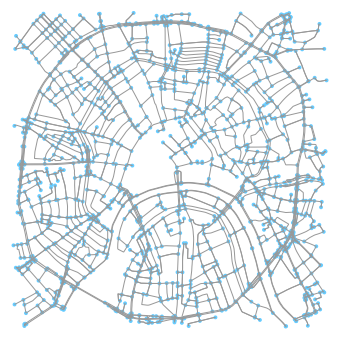

Object class: MultiDiGraph


In [4]:
ox.plot_graph(M)
print('Object class:', M.__class__.__name__)

This graph (or map) consists of *nodes* and *edges*, where nodes represent intersections and edges represent streets. Information about each node is stored in dictionaries and includes its coordinates and unique *osmID*. For example, `438099970` node can be extracted this way:

In [5]:
print(M.nodes(data = True)[438099970])

{'y': 55.766336, 'x': 37.6091562, 'osmid': 438099970}


### Supplementing the data

Before proceeding, we first need to supply our graph with data on streets' elevation in case we need it later.
*OSMnx* [provides](https://osmnx.readthedocs.io/en/stable/osmnx.html#module-osmnx.elevation) a simple mechanism for getting nodes' altitude using Google's Elevation API, but we will retrieve it from another source — the [Elevation-API](https://elevation-api.io).

For each node, its "latitute-longitude" pair is concantenated to the API's request. Requested output is then added to the dictionary by the `elevation` key:

In [6]:
# Might be long to run!

API_key = 'dpdc1bp92p4d1VgcMg-uvifid514-t'

for node in M.nodes():
    y = M.nodes[node]['y'] # latitude
    x = M.nodes[node]['x'] # longitude
    response = requests.get('https://elevation-api.io/api/elevation?points=(' + 
                           str(y) + ',' + str(x) + ')&key=' + API_key)
    if response:
        elevation = response.json()['elevations'][0]['elevation']
        M.nodes[node]['elevation'] = elevation
    else:
        M.nodes[node]['elevation'] = -9999
        print('No response!')

Now *OSMnx* can automatically calculate elevation grades of the edges (streets):

In [7]:
M = ox.elevation.add_edge_grades(M, add_absolute=True)

___

## Map prerequisites

### Setting the month of observation

We need to know the sunrise and sunset azimuths (`rise_angle` and `set_angle` respectively) and the time of their start (`rise_time` and `set_time`) depending on the month of observation. 

Monthly data is retrieved using [`astral`](https://astral.readthedocs.io) package observing on 15th day of the month.

In [8]:
month = 12

In [9]:
l = astral.LocationInfo() # set location properties
l.name = 'Moscow'            # city name
l.region = 'Russia'          # region
l.timezone = 'Europe/Moscow' # timezone (pytz style)
l.latitude = lat             # latitude
l.longitude = long           # longitude

date_str = str(datetime.now().year) + '-' + str(month) + '-' + '15' # set date (based on month)
date_obj = datetime.strptime(date_str, '%Y-%m-%d') # convert to datetime object
s = sun(l.observer, date=date_obj) # get dictionary with solar time data

Now we define `rise_time` and `set_time` according to an appropriate timezone (UTC+3). We also create a `month_name` variable (in case we need it in map legend).

In [10]:
rise_time_obj = s['sunrise'].astimezone(tz = pytz.timezone(l.timezone))
set_time_obj = s['sunset'].astimezone(tz = pytz.timezone(l.timezone))

rise_time = datetime.strftime(rise_time_obj, '%H:%M:%S')
set_time = datetime.strftime(set_time_obj, '%H:%M:%S')

month_name = calendar.month_name[month]

Finally, `rise_angle` and `set_angle` are calculated as follows:

In [11]:
rise_angle = azimuth(l.observer, rise_time_obj)
set_angle = azimuth(l.observer, set_time_obj)

### Unpacking and processing the data

Edges are stored in massive object called by `M.edges(data=True)` that contains:
- IDs of two nodes (`u` and `v`) that define an edge;
- Edges' properties stored in dictionaries (`data`).

The following code unpacks it.

In [12]:
u = []
v = []
data = []
for uu, vv, ddata in M.edges(data=True):
    u.append(uu)
    v.append(vv)
    data.append(ddata)

for item in data:
    if 'bearing' in item.keys():
        item['bearing'] = float(item['bearing'])

Now we have two vectors of edge-forming nodes (`u` and `v`) and the vector of dictionaries (`data`).

### Defining colors

Let's start with two HEX colors denoting whether a street is appropriate for sunrise or sunset observation. I chose <span style="color:#FFFE03; background-color:#181A34">#FFFE03</span> as the sunrise color and <span style="color:#E70074; background-color:#181A34">#E70074</span> as the sunset color. `bg_color` represents the background color of the map.

In [13]:
rise_color = '#FFFE03' # yellow
set_color = '#E70074'  # magenta
no_color = '#3A3F80'   # dark-ish blue
bg_color = '#181A34'   # dark blue

### Setting street colors

`colorHEX` list contains edge colors which depend on the bearings. We also include street length restriction (`item['length'] > 10`) in order to omit insignificant street network units.

In [14]:
colorsHEX = []

for item in data:
    if item['length'] > 10:
        if abs(item['bearing'] - rise_angle) <= 10 or abs(item['bearing'] - rise_angle - 180) <= 10:
            colorHEX = rise_color
        elif abs(item['bearing'] - set_angle) <= 10 or abs(item['bearing'] - set_angle + 180) <= 10:
            colorHEX = set_color
        else:
            colorHEX = no_color
    else:
        colorHEX = bg_color
    colorsHEX.append(colorHEX)

### Setting street width

Each edge will be printed with a certain width according to the street type. Firts, let's build a list of edge grades and print out a set of unique ones:

In [15]:
types = []

for item in data:
    if  isinstance(item['highway'], str):
        types.append(item['highway'])

print('Street types available:')
print(*np.unique(np.array(types)), sep = ', ')

Street types available:
living_street, primary, primary_link, residential, secondary, secondary_link, tertiary, tertiary_link, unclassified


Now it is possible to form the `widths` list:

In [16]:
widths = []

for item in data:
    if 'primary' or 'primary_link' in item['highway']:
        width = 5
    elif 'secondary' or 'secondary_link' in item['highway']:
        width = 3
    elif 'tertiary' or 'tertiary_link' in item['highway']:
        width = 2
    elif 'residential' or 'living_street' in item['highway']:
        width = 1
    else:
        width = 0
    widths.append(width)

___

## Map compilation

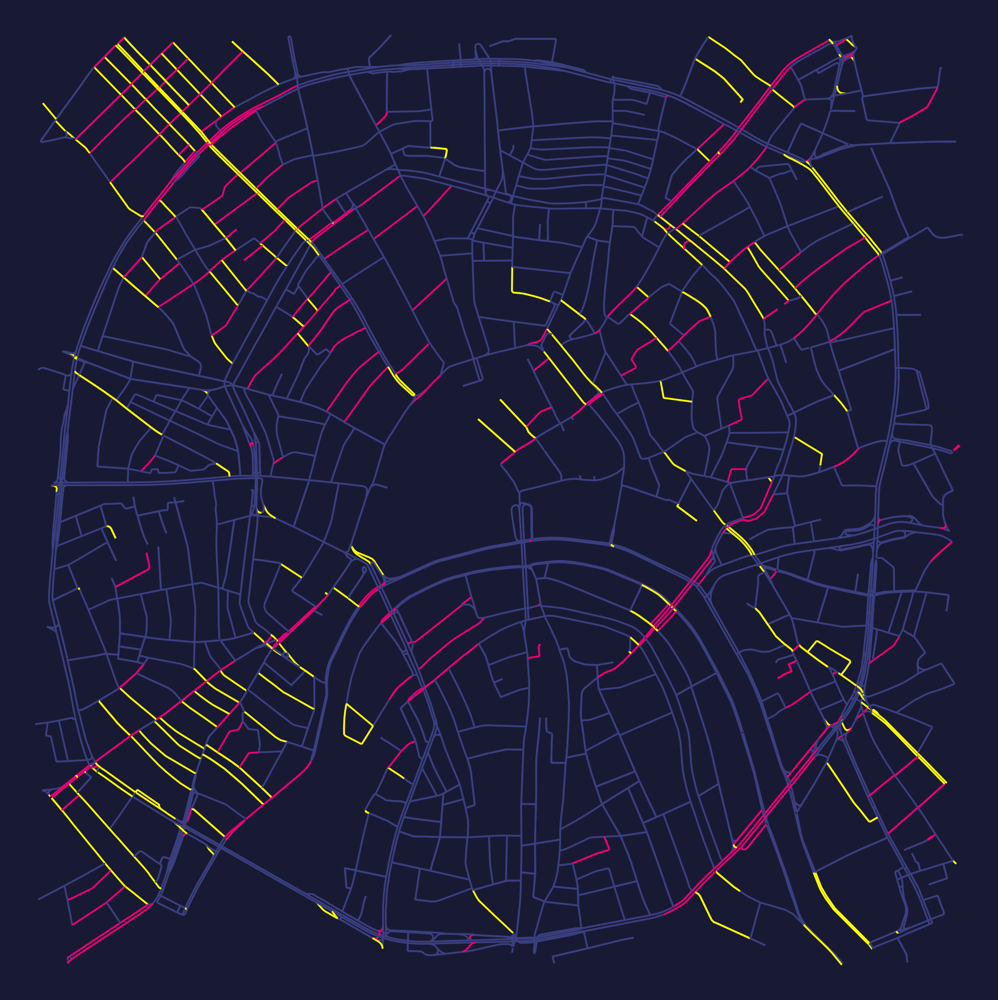

In [17]:
# Map center

latitude = 55.7518
longitude = 37.6224

# Plotting

fig, ax = ox.plot_graph(M, node_size=0, margin = 0.035,
                        fig_height=50, fig_width=50, bgcolor = bg_color,
                        save = False, edge_color=colorsHEX,
                        edge_linewidth=widths, use_geom = True)

### Legend

Here we add a legend describing edge colors. It is not seen in the output, but appears in `test.svg` or `test.png` file.

In [18]:
markersize = 12
fontsize = 40

legend_elements = [Line2D([0], [0], marker='_', color=rise_color, label= 'Sunrise watching appropriate',
                          markersize=markersize, linewidth=5),
                          
                  Line2D([0], [0], marker='_', color=set_color, label= 'Sunset watching appropriate',
                         markersize=markersize, linewidth=5),
                  
                  Line2D([0], [0], marker='_', color=no_color, label= 'Inappropriate for sun observation',
                         markersize=markersize, linewidth=5)
                  ]    
                      
l = ax.legend(handles=legend_elements, bbox_to_anchor=(0.0, 0.0), frameon=True, ncol=1,
              facecolor = '#181A34', framealpha = 0.9,
              loc='lower left',  fontsize = fontsize, prop={'family':'monospace', 'size':fontsize})

for text in l.get_texts():
    text.set_color("w")

In [19]:
"""
fig.savefig("test.svg", bbox_inches = 'tight', 
            format = "svg", facecolor = fig.get_facecolor(), 
            transparent = True)
"""

fig.savefig("test.png", dpi=50, bbox_inches='tight', 
            format="png", facecolor=fig.get_facecolor(), 
            transparent=True)

___

## Further investigation

### Plotting edge grades using alpha channel

The map above only takes edge *bearings* into account. Now we will examine the possibility of seizing the *elevation* (grades) data for the map plotting purposes. First, let's check how *grades* are distributed (note that we are only interested in absolute values):

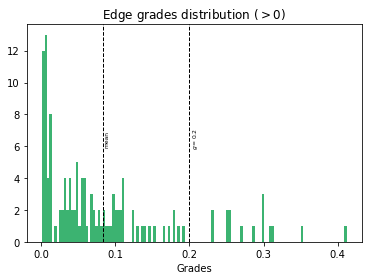

Range of non-zero grades: (0.0011, 0.4121)


In [20]:
grades = []

for item in data:
    grades.append(float(item['grade_abs']))

grades_nz = [g for g in grades if g != 0]
grades_np = np.array(grades_nz)

# Plot the distribution:

plt.hist(grades_np, 
         bins=len(grades_np), 
         color = 'mediumseagreen')
plt.title('Edge grades distribution ($>0$)')
plt.xlabel('Grades')
plt.axvline(x = np.mean(grades_np), 
            color = 'black', 
            linestyle = 'dashed', 
            linewidth = 1)
plt.axvline(x = 0.2, 
            color = 'black', 
            linestyle = 'dashed', 
            linewidth = 1)
plt.text(0.085, 6, 'mean', rotation=90, fontsize=6)
plt.text(0.2016, 6, '$g = 0.2$', rotation=90, fontsize=6)
plt.rcParams['figure.dpi']= 150 # dpi of output images
plt.show()

print('Range of non-zero grades: ({}, {})'.format(min(grades_nz), max(grades_nz)))

We might highlight edges which grade exceeds a predefined value (e. g., zero or the mean grade). In order to do so, a new color vector is created: it will consist of RGBA-coded colors, where *A* stands for opacity level (alpha). For better presentation, the color of "sun observation inappropriate" streets is now white.

In [21]:
def f_colorsRGBA(boundary):
    
    colorsRGBA = []

    for item in data:

        if item['length'] > 10: # familiar bearing condition
            if abs(item['bearing'] - rise_angle) <= 10 or abs(item['bearing'] - rise_angle - 180) <= 10:
                colorHEX = rise_color
            elif abs(item['bearing'] - set_angle) <= 10 or abs(item['bearing'] - set_angle + 180) <= 10:
                colorHEX = set_color
            else:
                colorHEX = '#FFFFFF'
        else:
            colorHEX = bg_color

        if item['grade_abs'] > boundary: # grade condition
            a = 1
        else:
            a = 0.2

        colorRGB = hex2rgb(colorHEX, normalise=True)
        colorRGBA = colorRGB + (a,)
        colorsRGBA.append(colorRGBA)
        
    return colorsRGBA

- All streets with **non-zero grades** are highlighted:

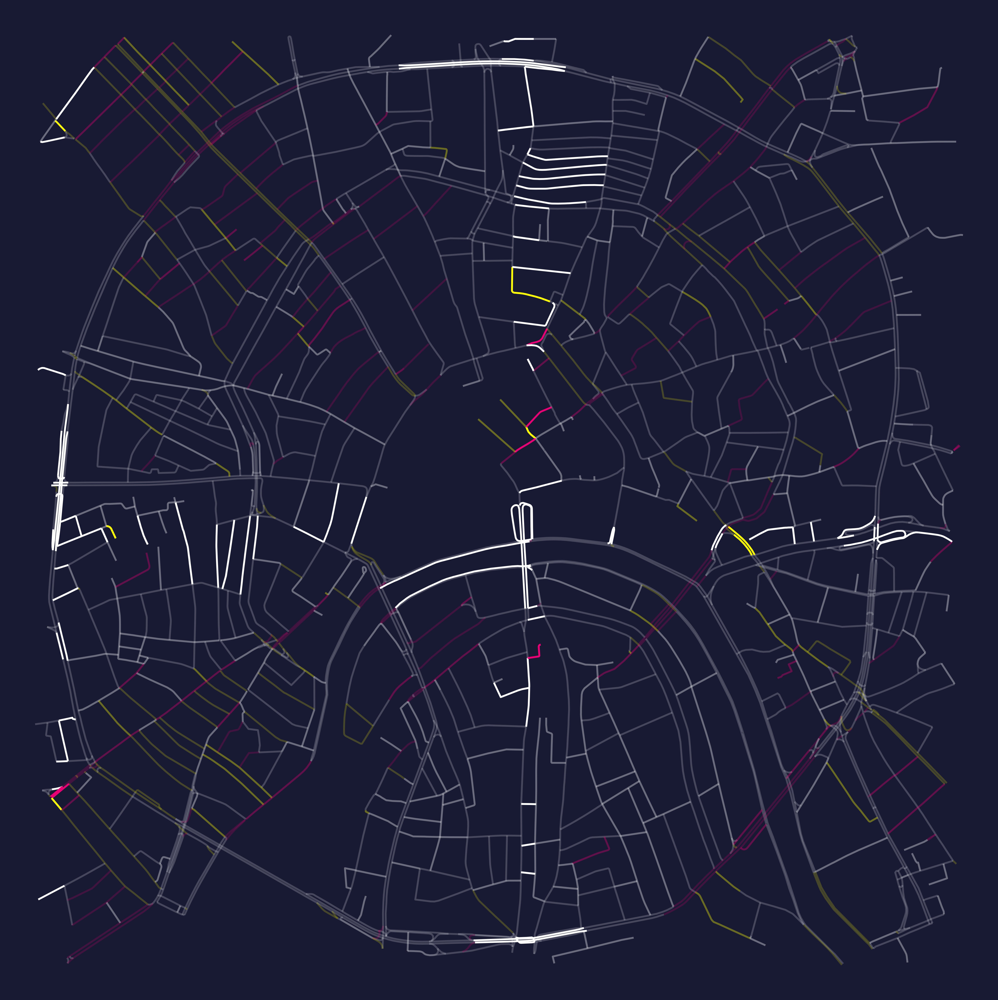

In [22]:
# Boundary grade

boundary = 0

# Map center

latitude = 55.7518
longitude = 37.6224

# Plotting

fig_bz, ax = ox.plot_graph(M, node_size=0, margin = 0.035,
                        fig_height=50, fig_width=50, bgcolor = bg_color,
                        save = False, edge_color=f_colorsRGBA(boundary),
                        edge_linewidth=widths, edge_alpha=None, use_geom = True)

- **Grades exceeding the mean value** (≈0.08) are highlighted:

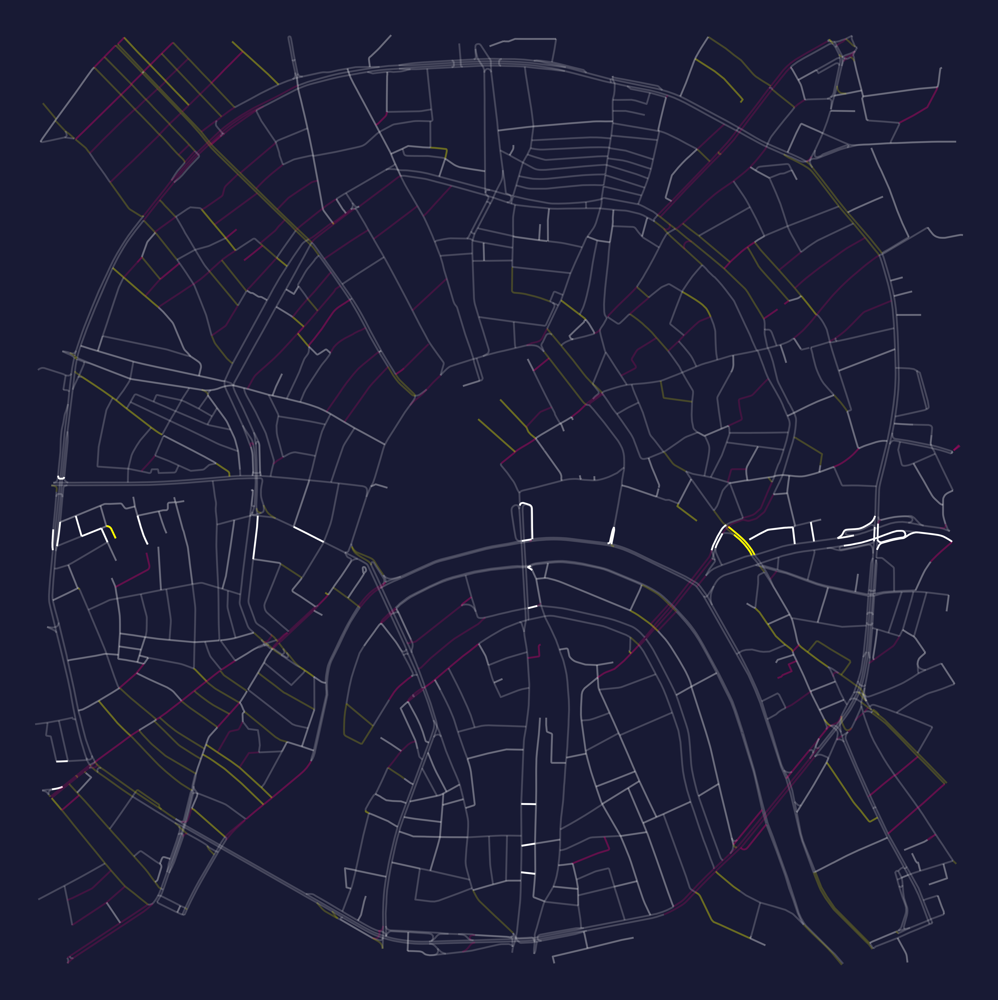

In [23]:
# Boundary grade

boundary = np.mean(grades_np)

# Map center

latitude = 55.7518
longitude = 37.6224

# Plotting

fig_bm, ax = ox.plot_graph(M, node_size=0, margin = 0.035,
                        fig_height=50, fig_width=50, bgcolor = bg_color,
                        save = False, edge_color=f_colorsRGBA(boundary),
                        edge_linewidth=widths, edge_alpha=None, use_geom = True)

Taking the general Moscow knowledge into account, we propose to use 0 (zero) as a boundary grade. Please note that elevation API provides rought estimates of geographical data, therefore, our visual investigation might omit significant areas.

### Plotting elevation using node colors

As an alterative to grades representation, it is also possible to paint nodes according to their **absolute elevation**.

In [25]:
from sklearn.preprocessing import minmax_scale

elevations = [M.nodes()[node]['elevation'] for node in M.nodes()]
elevations_scaled = minmax_scale(elevations, feature_range=(0, 1)) # scale elevations from 0 to 1

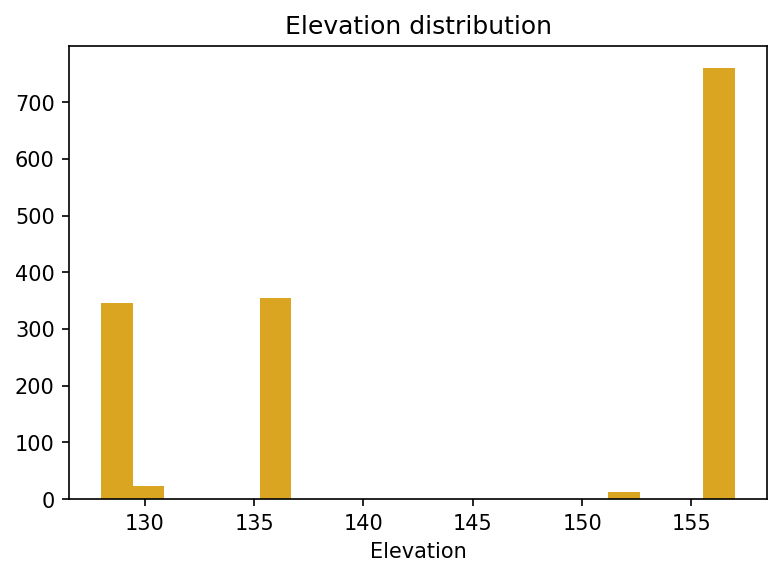

Range of elevation: (128.0, 157.0)


In [26]:
plt.hist(elevations, 
         color = 'goldenrod', bins = 20)
plt.title('Elevation distribution')
plt.xlabel('Elevation')
plt.rcParams['figure.dpi']= 150 # dpi of output images
plt.show()

print('Range of elevation: ({}, {})'.format(min(elevations), max(elevations)))

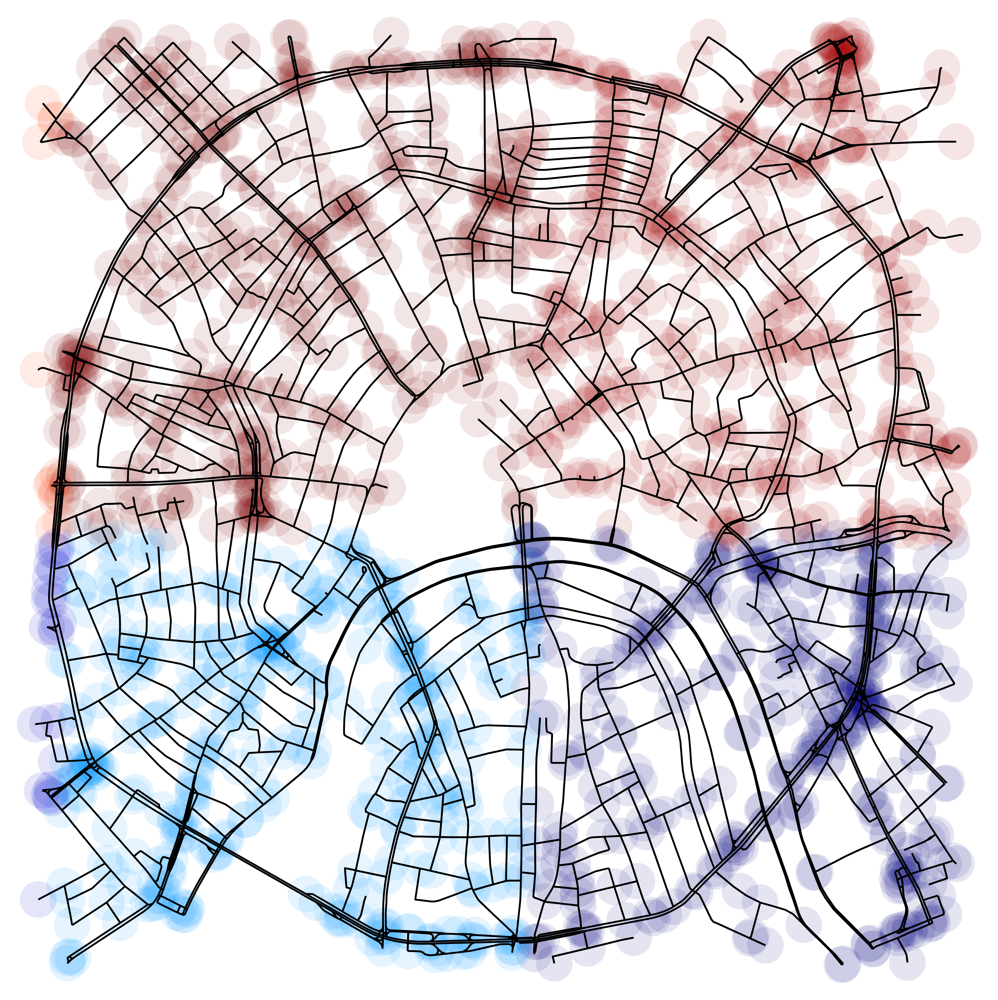

In [27]:
# Map center

latitude = 55.7518
longitude = 37.6224
cmap = plt.get_cmap('jet') # setting colormap

# Plotting

fig, ax = ox.plot_graph(M, node_size=10000, margin = 0.035,
                        fig_height=50, fig_width=50, bgcolor = 'white',
                        save = False, edge_color='#000000', 
                        node_color = cmap(elevations_scaled), node_alpha = 0.1,
                        edge_linewidth=widths, use_geom = True)

___

___

# Generalized case

`astral` package enables us to automatically set the location of the map and build it similar to the Moscow case. Its database initially contains capital cities only, but it can be manually supplemented (see the [docs](https://astral.readthedocs.io/en/latest/package.html#astral.geocoder.add_locations)).

In [28]:
month = 7
city = 'Amsterdam'

In [29]:
from astral.geocoder import database, lookup
l = lookup(city, database()) # load city properties

In [30]:
date_str = str(datetime.now().year) + '-' + str(month) + '-' + '15' # set date (based on month)
date_obj = datetime.strptime(date_str, '%Y-%m-%d') # convert to datetime object
s = sun(l.observer, date=date_obj) # get dictionary with solar time data

rise_time_obj = s['sunrise'].astimezone(tz = pytz.timezone(l.timezone))
set_time_obj = s['sunset'].astimezone(tz = pytz.timezone(l.timezone))

rise_time = datetime.strftime(rise_time_obj, '%H:%M:%S')
set_time = datetime.strftime(set_time_obj, '%H:%M:%S')

rise_angle = azimuth(l.observer, rise_time_obj)
set_angle = azimuth(l.observer, set_time_obj)

month_name = calendar.month_name[month]

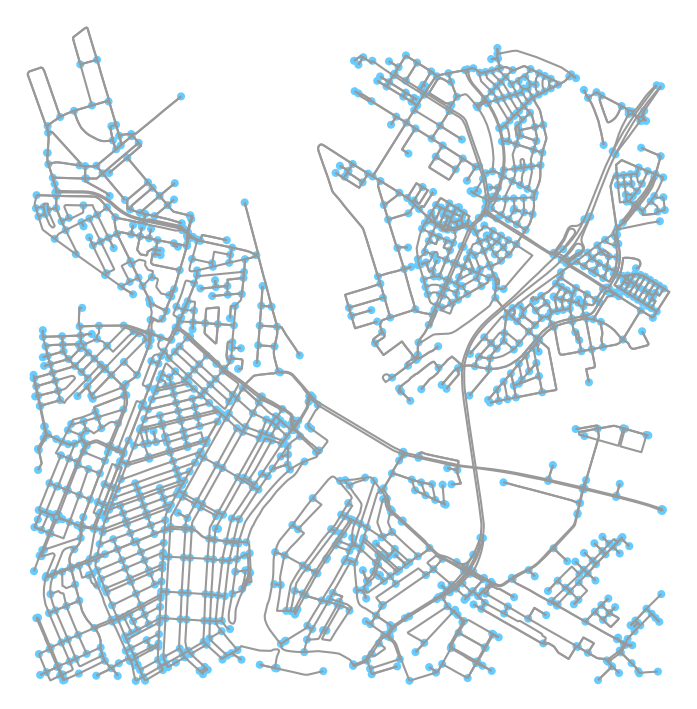

(<Figure size 1447.65x900 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1a2780d850>)

In [31]:
G = ox.geo_utils.add_edge_bearings(
    ox.graph_from_point((l.latitude, l.longitude), distance=2000, network_type='drive')
)

ox.plot_graph(G)

In [32]:
u = []
v = []
data = []
for uu, vv, ddata in G.edges(data=True):
    u.append(uu)
    v.append(vv)
    data.append(ddata)

for item in data:
    if 'bearing' in item.keys():
        item['bearing'] = float(item['bearing'])

In [33]:
colorsHEX = []

for item in data:
    if item['length'] > 10:
        if abs(item['bearing'] - rise_angle) <= 10 or abs(item['bearing'] - rise_angle - 180) <= 10:
            colorHEX = rise_color
        elif abs(item['bearing'] - set_angle) <= 10 or abs(item['bearing'] - set_angle + 180) <= 10:
            colorHEX = set_color
        else:
            colorHEX = no_color
    else:
        colorHEX = bg_color
    colorsHEX.append(colorHEX)

In [34]:
widths = []

for item in data:
    if 'primary' or 'primary_link' in item['highway']:
        width = 5
    elif 'secondary' or 'secondary_link' in item['highway']:
        width = 3
    elif 'tertiary' or 'tertiary_link' in item['highway']:
        width = 2
    elif 'residential' or 'living_street' in item['highway']:
        width = 1
    else:
        width = 0
    widths.append(width)

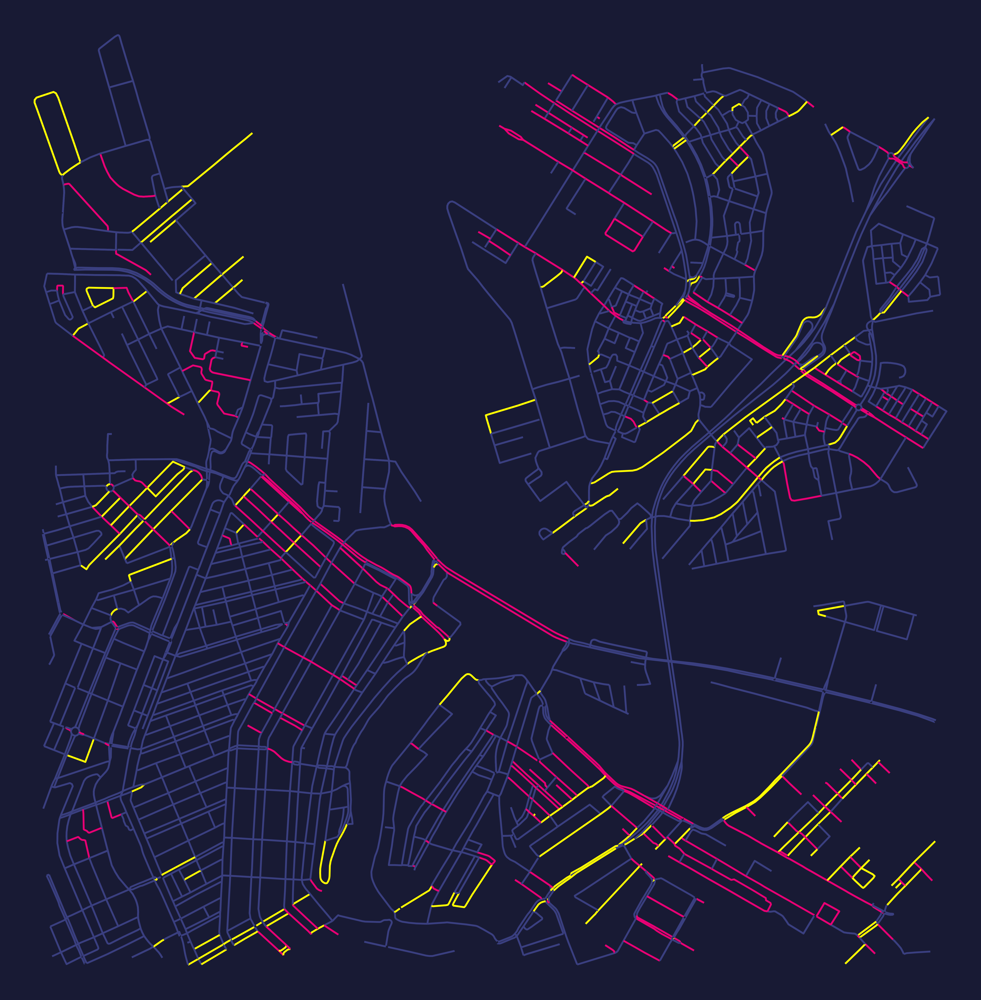

In [35]:
# Map center

latitude = l.latitude
longitude = l.longitude

# Plotting

fig, ax = ox.plot_graph(G, node_size=0, margin = 0.035,
                        fig_height=50, fig_width=50, bgcolor = bg_color,
                        save = False, edge_color=colorsHEX,
                        edge_linewidth=widths, use_geom = True)

## Acknowledgements

- Boeing, G. 2017. *“OSMnx: New Methods for Acquiring, Constructing, Analyzing, and Visualizing Complex Street Networks.”* Computers, Environment and Urban Systems. 65, 126-139. [doi:10.1016/j.compenvurbsys.2017.05.004](https://doi.org/10.1016/j.compenvurbsys.2017.05.004)
- Ceballos, Frank. *“Making Artistic Maps with Python.”* Towards Data Science. Last modified October 2, 2019. [towardsdatascience.com/making-artistic-maps-with-python-9d37f5ea8af0](https://towardsdatascience.com/making-artistic-maps-with-python-9d37f5ea8af0).